### Data Analysis

In [61]:
import os
from math import ceil
import matplotlib.pyplot as plt
from PIL import Image
import shutil
import numpy as np

import tensorflow as tf
from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import Model

from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

from skimage import io, color, exposure
from skimage.filters import sobel, gabor

import Counter
import math

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [62]:
image_dir = '/content/drive/MyDrive/ChallengeIAM2/imagettes/imagettes'

image_files = [os.path.join(image_dir, f) for f in os.listdir(image_dir)
               if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

print(f"Found {len(image_files)} images.")

from PIL import Image

if image_files:
    img = Image.open(image_files[0])
    img.show()

Found 1396 images.


In [79]:
source_dir = '/content/drive/MyDrive/ChallengeIAM2/base_sure'

dest_root = '/content/drive/MyDrive/ChallengeIAM2/base_sure_grouped_by_project'
if not os.path.exists(dest_root):
    os.makedirs(dest_root)
image_files = [f for f in os.listdir(source_dir)
               if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

for filename in image_files:
    parts = filename.split('-')
    if len(parts) < 3:
        print(f"Skipping file with unexpected format: {filename}")
        continue

    project_name = parts[2]

    project_dir = os.path.join(dest_root, project_name)
    if not os.path.exists(project_dir):
        os.makedirs(project_dir)

    src_path = os.path.join(source_dir, filename)
    dest_path = os.path.join(project_dir, filename)

    shutil.copy(src_path, dest_path)
    print(f"Copied {filename} to {project_dir}")


Copied 0.248699801164882770.29170819060520460.09889708693670407-5_5_5_5-Ecopic_2018-0.658203125-0.81201171875-0.244140625-0.3466796875.jpg to /content/drive/MyDrive/ChallengeIAM2/base_sure_grouped_by_project/Ecopic_2018
Copied 0.83363206220033360.176109107276474660.2705574542045135-1_1_1_1-TIDM_URBA_DIJON2021_2_3-0.17643229166666666-0.870361328125-0.3157552083333333-0.25830078125.jpg to /content/drive/MyDrive/ChallengeIAM2/base_sure_grouped_by_project/TIDM_URBA_DIJON2021_2_3
Copied 0.087601306448350740.160129879976934730.9685882660543307-0_0_0_0-Bioindicateur_2_2009_2010-0.2501627604166667-0.76416015625-0.4951171875-0.470703125.jpg to /content/drive/MyDrive/ChallengeIAM2/base_sure_grouped_by_project/Bioindicateur_2_2009_2010
Copied 0.77891223736449740.181494697360175430.8430546541604085-6_6_6_6-TIDM_URBA_DIJON2021_1_3-0.6593424479166666-0.4716796875-0.13248697916666666-0.5478515625.jpg to /content/drive/MyDrive/ChallengeIAM2/base_sure_grouped_by_project/TIDM_URBA_DIJON2021_1_3
Copied 0

In [ ]:
base_dir='/content/drive/MyDrive/ChallengeIAM2/imagettes/grouped_by_project'
project_names = [name for name in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, name))]

print("Project names:")
for project in project_names:
    print(project)

Project names:
Pompey_1_2007
Bioindicateur_2_2009_2010
TIDM_URBA_DIJON2021_2_3
Parcelles_Lysime╠ütriques_Sept_2007_2008_3
TIDM_URBA_DIJON2021_1_3
PEY_Benjamin_10_2007
VADEBIO_2010
TIDM_URBA_DIJON2021_3_3
Ecopic_2018
Parcelles_Lysime╠ütriques_Sept_2007_2
NARBONS
RMQS_Biodiv_Printemps_2007
RMQS_Biodiv_Printemps_2006
_Howe╠ücourt_TQ_09_04_08.Vadebio
Parcelles_Lysime╠ütriques_Sept_2007_1
PEY_Benjamin_10_2014
Bretagne_2_RMQS_Biodiv_Printemps_2007
PEY_Benjamin_10_2017
PEY_Benjamin_10_2018
TIDM_URBA_DIJON2021_1_9
TIDM_URBA_DIJON2021_1_4
nd
PEY_Benjamin_10_2013
Celine_Isacs_Litie╠Çre_boite_rouge
PEY_Benjamin_10_2008
TIDM_URBA_DIJON2021_2_4
PEY_Benjamin_10_2010
PEY_Benjamin_10_2016
PEY_Benjamin_10_2009
Ecopic_2019
PEY_Benjamin_10_2011
PEY_Benjamin_10_2015
PEY_Benjamin_10_2012


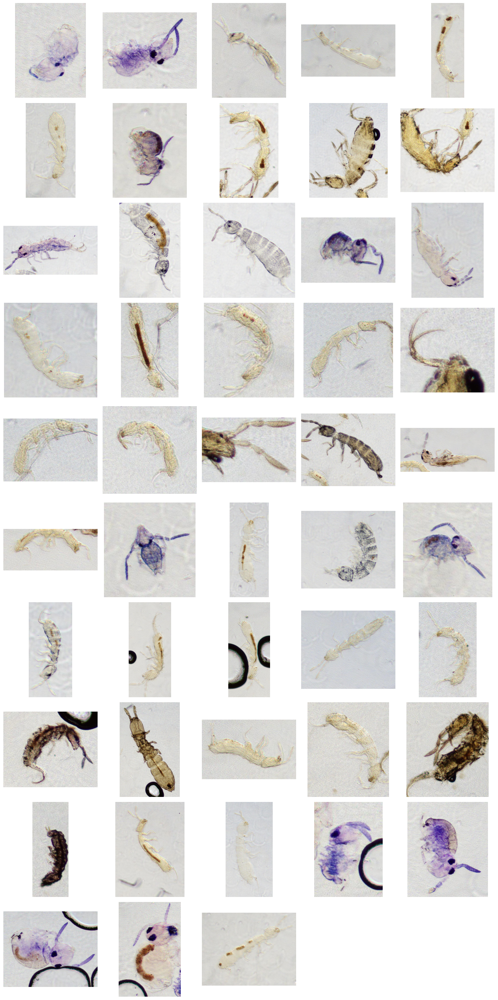

In [ ]:
def display_project_images(project_name, base_dir='/content/drive/MyDrive/ChallengeIAM2/imagettes/grouped_by_project', n_images=50, n_cols=5):
    project_folder = os.path.join(base_dir, project_name)

    if not os.path.exists(project_folder):
        print(f"Project folder not found: {project_folder}")
        return

    image_files = [f for f in os.listdir(project_folder) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

    if not image_files:
        print(f"No image files found in {project_folder}")
        return
    selected_images = image_files[:n_images]
    num_images = len(selected_images)

    n_rows = ceil(num_images / n_cols)
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(15, 3 * n_rows))

    try:
        axes = axes.flatten()
    except AttributeError:
        axes = [axes]

    for i, img_name in enumerate(selected_images):
        img_path = os.path.join(project_folder, img_name)
        try:
            img = Image.open(img_path)
            axes[i].imshow(img)
            axes[i].set_axis_off()
        except Exception as e:
            print(f"Skipping {img_name} due to error: {e}")
            axes[i].set_axis_off()

    for j in range(i + 1, len(axes)):
        axes[j].set_axis_off()

    plt.tight_layout()
    plt.show()



display_project_images("TIDM_URBA_DIJON2021_3_3")


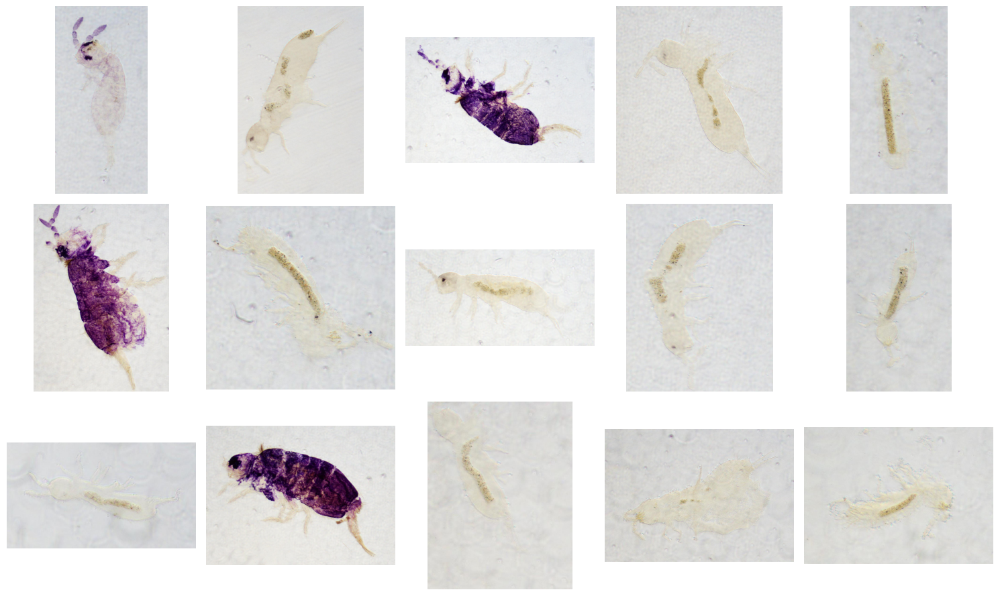

In [ ]:
display_project_images("RMQS_Biodiv_Printemps_2006")


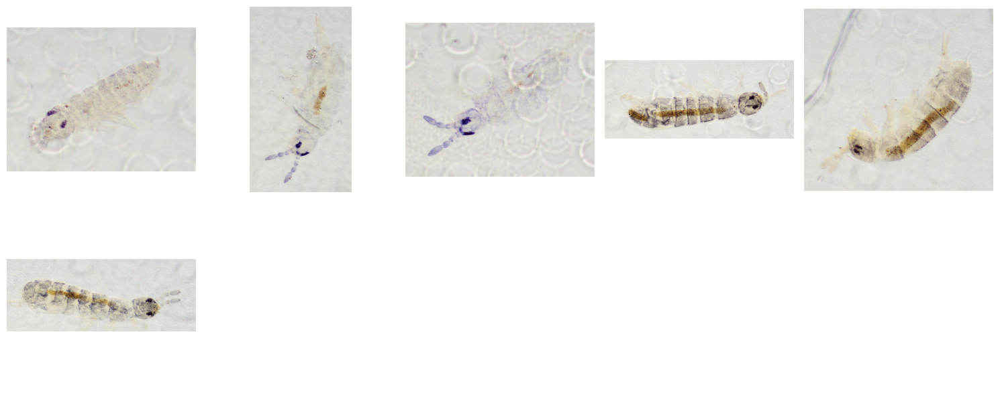

In [ ]:
display_project_images("Bretagne_2_RMQS_Biodiv_Printemps_2007")

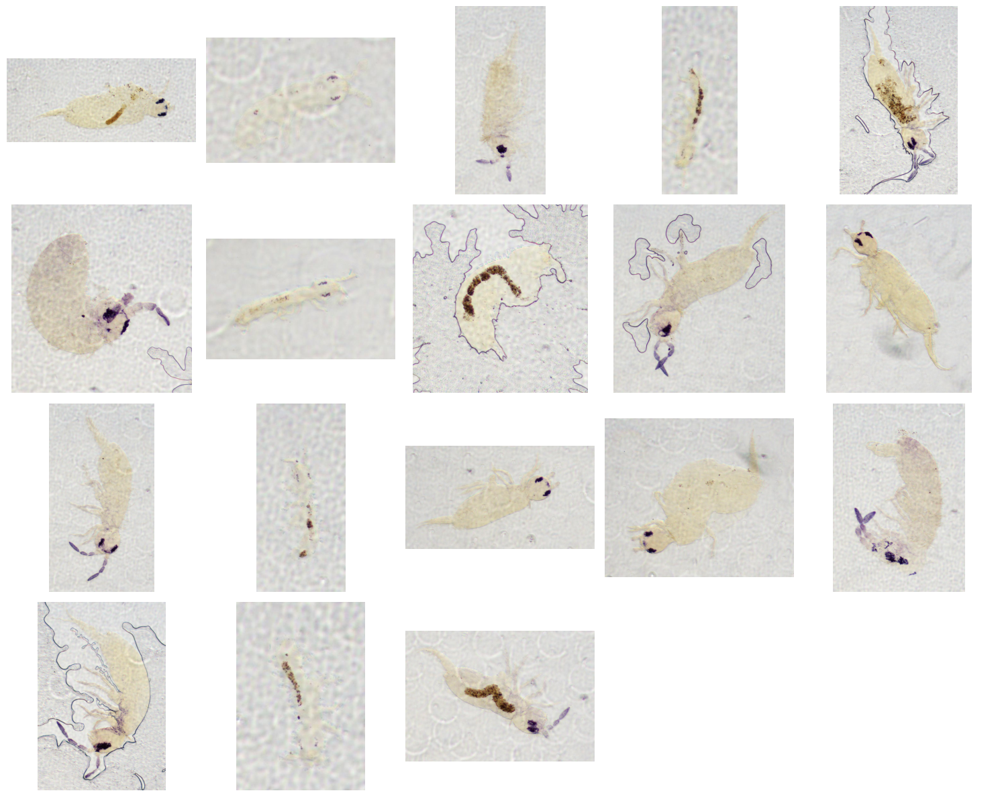

In [ ]:
display_project_images("Parcelles_Lysime╠ütriques_Sept_2007_2")

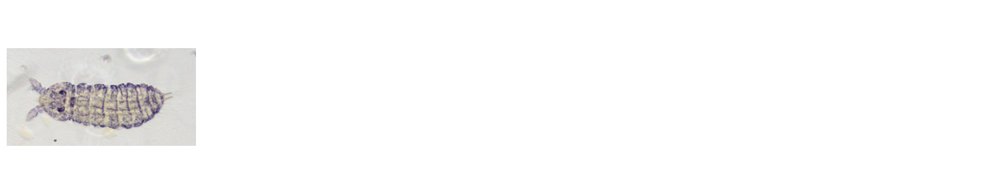

In [ ]:
display_project_images("Celine_Isacs_Litie╠Çre_boite_rouge")

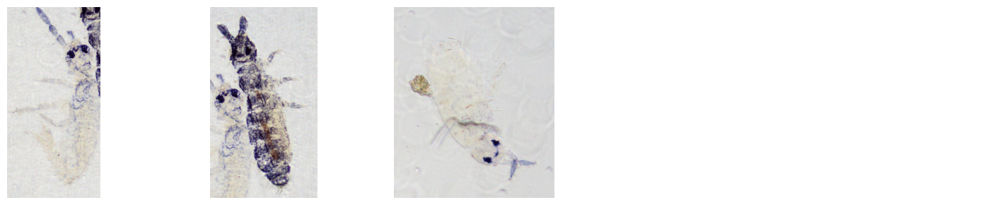

In [ ]:
display_project_images("nd")

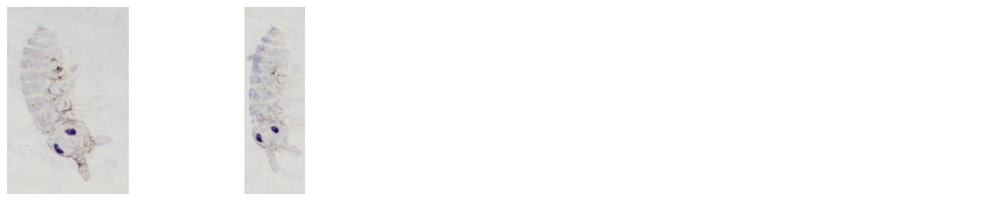

In [ ]:
display_project_images("Ecopic_2019")

### TSNE

Projects found: ['Pompey_1_2007', 'Bioindicateur_2_2009_2010', 'TIDM_URBA_DIJON2021_2_3', 'Parcelles_Lysime╠ütriques_Sept_2007_2008_3', 'TIDM_URBA_DIJON2021_1_3', 'PEY_Benjamin_10_2007', 'VADEBIO_2010', 'TIDM_URBA_DIJON2021_3_3', 'Ecopic_2018', 'Parcelles_Lysime╠ütriques_Sept_2007_2', 'NARBONS', 'RMQS_Biodiv_Printemps_2007', 'RMQS_Biodiv_Printemps_2006', '_Howe╠ücourt_TQ_09_04_08.Vadebio', 'Parcelles_Lysime╠ütriques_Sept_2007_1', 'PEY_Benjamin_10_2014', 'Bretagne_2_RMQS_Biodiv_Printemps_2007', 'PEY_Benjamin_10_2017', 'PEY_Benjamin_10_2018', 'TIDM_URBA_DIJON2021_1_9', 'TIDM_URBA_DIJON2021_1_4', 'nd', 'PEY_Benjamin_10_2013', 'Celine_Isacs_Litie╠Çre_boite_rouge', 'PEY_Benjamin_10_2008', 'TIDM_URBA_DIJON2021_2_4', 'PEY_Benjamin_10_2010', 'PEY_Benjamin_10_2016', 'PEY_Benjamin_10_2009', 'Ecopic_2019', 'PEY_Benjamin_10_2011', 'PEY_Benjamin_10_2015', 'PEY_Benjamin_10_2012']
Found 1396 images total.
ResNet50 model loaded.
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 463m

/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


t-SNE done.


<ipython-input-52-a0d94f0f7115>:82: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap("gist_ncar", 33)


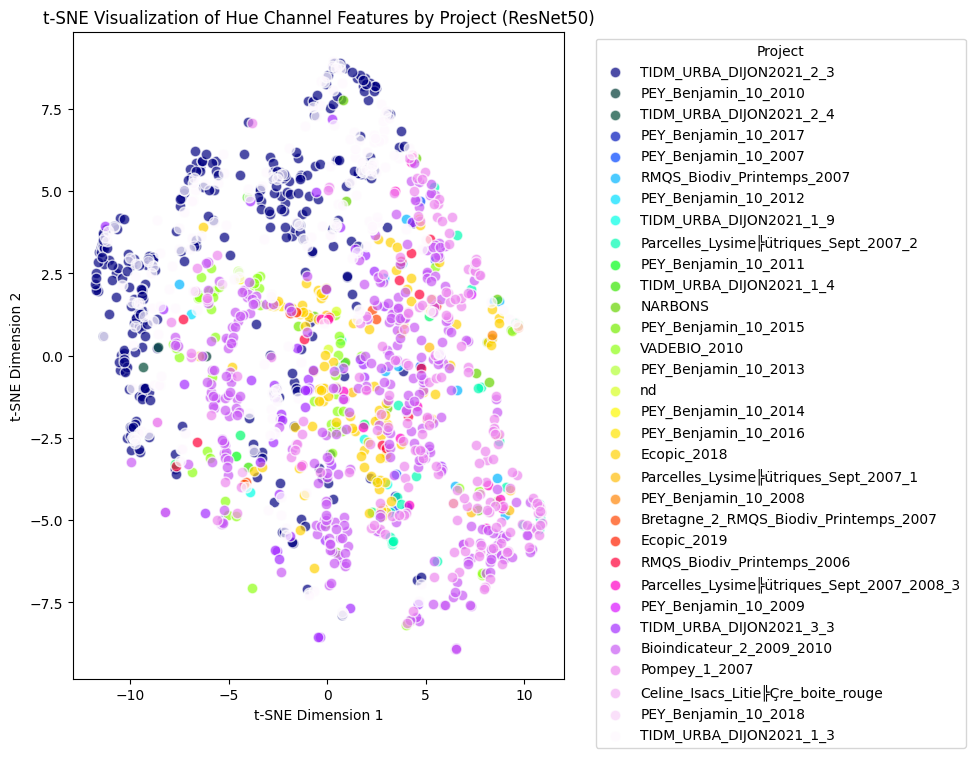

In [ ]:
base_dir = '/content/drive/MyDrive/ChallengeIAM2/imagettes/grouped_by_project'

project_names = [name for name in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, name))]
print("Projects found:", project_names)

image_paths = []
for proj in project_names:
    proj_dir = os.path.join(base_dir, proj)
    # Filter for image files (adjust extensions if needed)
    files = [f for f in os.listdir(proj_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    for f in files:
        image_paths.append((os.path.join(proj_dir, f), proj))

print(f"Found {len(image_paths)} images total.")

IMG_SIZE = (224, 224)

base_model = ResNet50(weights='imagenet', include_top=False, pooling='avg')
print("ResNet50 model loaded.")

def load_and_preprocess_image(img_path):
    try:
        img = image.load_img(img_path, target_size=IMG_SIZE)
        img_array = image.img_to_array(img)
        img_array = np.expand_dims(img_array, axis=0)
        img_array = preprocess_input(img_array)
        return img_array
    except Exception as e:
        print(f"Error processing {img_path}: {e}")
        return None

features = []
labels = []
failed = 0
for idx, (img_path, proj) in enumerate(image_paths):
    img_array = load_and_preprocess_image(img_path)
    if img_array is None:
        failed += 1
        continue
    feat = base_model.predict(img_array)
    features.append(feat.flatten())
    labels.append(proj)

print(f"Processed {len(features)} images successfully. Failed: {failed}")
features = np.array(features)

pca = PCA(n_components=50)
features_pca = pca.fit_transform(features)
print("PCA done. Total explained variance:", pca.explained_variance_ratio_.sum())

tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=300)
features_tsne = tsne.fit_transform(features_pca)
print("t-SNE done.")

plt.figure(figsize=(10, 8))
unique_labels = list(set(labels))
colors = plt.cm.get_cmap("gist_ncar", 33)

for i, label in enumerate(unique_labels):
    indices = [j for j, l in enumerate(labels) if l == label]
    plt.scatter(features_tsne[indices, 0], features_tsne[indices, 1],
                label=label, color=colors(i), alpha=0.7, edgecolors='w', s=60)

plt.legend(title="Project", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.title("t-SNE Visualization of Hue Channel Features by Project (ResNet50)")
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.tight_layout()
plt.show()


### Transformed features -Multiple methods

Selected Projects: ['TIDM_URBA_DIJON2021_1_9', 'Parcelles_Lysime╠ütriques_Sept_2007_1', 'PEY_Benjamin_10_2009', 'PEY_Benjamin_10_2016', 'RMQS_Biodiv_Printemps_2006', 'TIDM_URBA_DIJON2021_1_4', 'PEY_Benjamin_10_2013', 'PEY_Benjamin_10_2017', 'PEY_Benjamin_10_2015', 'Bioindicateur_2_2009_2010']


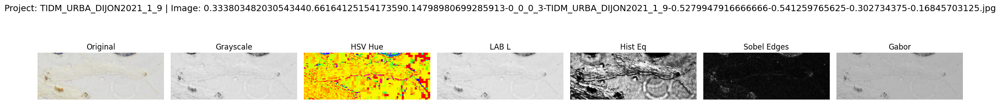

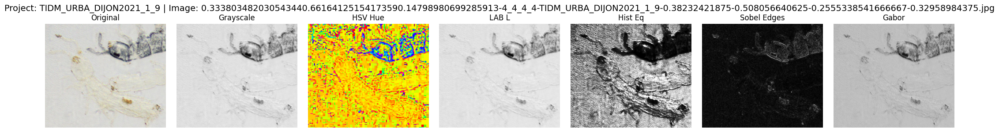

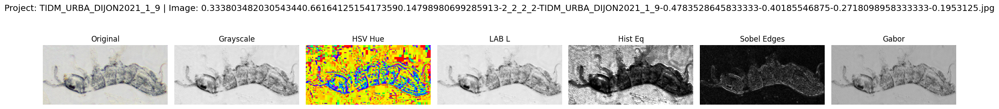

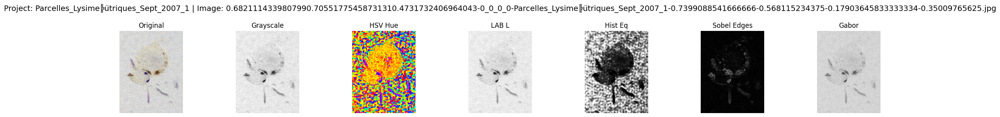

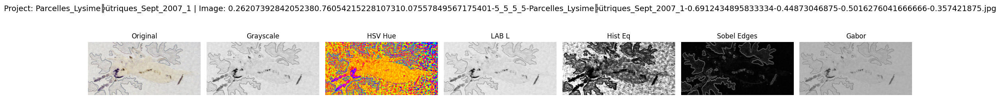

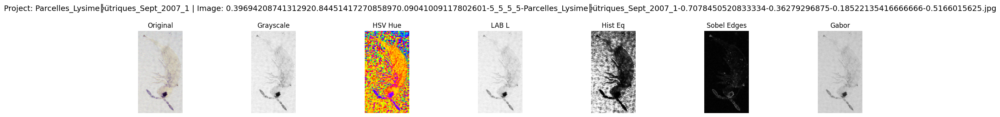

Project PEY_Benjamin_10_2009 has less than 3 images, skipping.
Project PEY_Benjamin_10_2016 has less than 3 images, skipping.


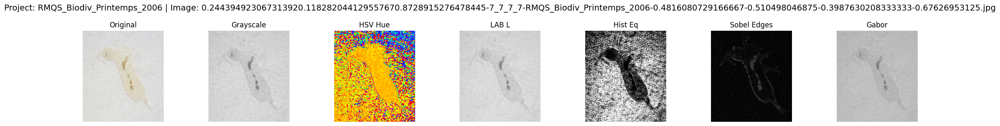

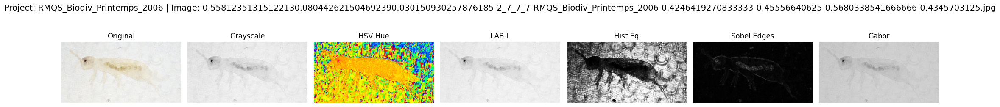

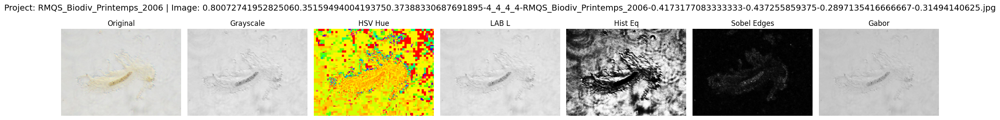

Project TIDM_URBA_DIJON2021_1_4 has less than 3 images, skipping.
Project PEY_Benjamin_10_2013 has less than 3 images, skipping.
Project PEY_Benjamin_10_2017 has less than 3 images, skipping.
Project PEY_Benjamin_10_2015 has less than 3 images, skipping.


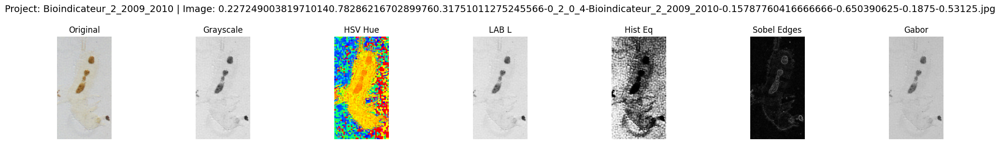

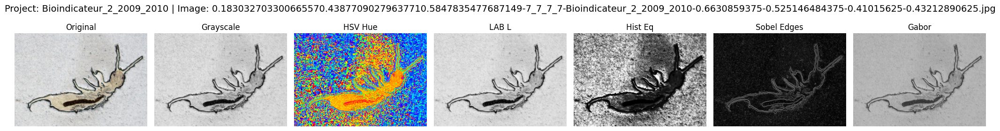

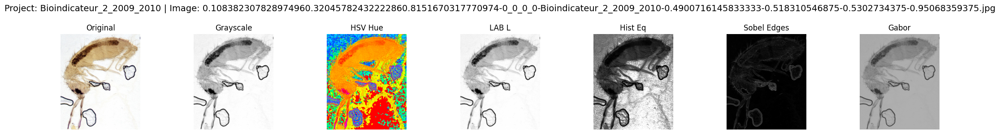

In [ ]:
base_dir = '/content/drive/MyDrive/ChallengeIAM2/imagettes/grouped_by_project'

all_projects = [d for d in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, d))]
if len(all_projects) < 5:
    print("Less than 5 projects found. Using all available projects.")
    selected_projects = all_projects
else:
    selected_projects = random.sample(all_projects, 10)

print("Selected Projects:", selected_projects)

for proj in selected_projects:
    proj_folder = os.path.join(base_dir, proj)
    image_files = [f for f in os.listdir(proj_folder) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    if len(image_files) < 3:
        print(f"Project {proj} has less than 3 images, skipping.")
        continue
    selected_images = random.sample(image_files, 3)

    for img_name in selected_images:
        img_path = os.path.join(proj_folder, img_name)
        try:
            img = io.imread(img_path)
        except Exception as e:
            print(f"Error reading {img_name} from {proj}: {e}")
            continue

        # 1. Original image
        original = img

        # 2. Grayscale conversion
        if original.ndim == 3:
            gray = color.rgb2gray(original)
        else:
            gray = original

        # 3. HSV Conversion: extract Hue channel
        if original.ndim == 3:
            hsv = color.rgb2hsv(original)
            hsv_hue = hsv[..., 0]
        else:
            hsv_hue = gray

        # 4. LAB Conversion: extract Luminance channel
        if original.ndim == 3:
            lab = color.rgb2lab(original)
            lab_l = lab[..., 0]
        else:
            lab_l = gray
        hist_eq = exposure.equalize_hist(gray)

        edges = sobel(gray)
        gabor_real, _ = gabor(gray, frequency=0.6)
        fig, axes = plt.subplots(1, 7, figsize=(21, 3))
        fig.suptitle(f'Project: {proj} | Image: {img_name}', fontsize=14)
        if original.ndim == 3:
            axes[0].imshow(original)
        else:
            axes[0].imshow(original, cmap='gray')
        axes[0].set_title("Original")
        axes[0].axis('off')

        # Grayscale
        axes[1].imshow(gray, cmap='gray')
        axes[1].set_title("Grayscale")
        axes[1].axis('off')

        # HSV Hue
        axes[2].imshow(hsv_hue, cmap='hsv')
        axes[2].set_title("HSV Hue")
        axes[2].axis('off')

        # LAB Luminance
        axes[3].imshow(lab_l, cmap='gray')
        axes[3].set_title("LAB L")
        axes[3].axis('off')

        # Histogram Equalization
        axes[4].imshow(hist_eq, cmap='gray')
        axes[4].set_title("Hist Eq")
        axes[4].axis('off')

        # Sobel Edges
        axes[5].imshow(edges, cmap='gray')
        axes[5].set_title("Sobel Edges")
        axes[5].axis('off')

        # Gabor Filter (Texture Analysis)
        axes[6].imshow(gabor_real, cmap='gray')
        axes[6].set_title("Gabor")
        axes[6].axis('off')

        plt.tight_layout()
        plt.savefig(f"/content/gabor_{proj}_{img_name}.png")
        plt.show()


### Distribution of labels within every project

In [78]:
base_dir =  '/content/drive/MyDrive/ChallengeIAM2/imagettes/grouped_by_project'
# Get project folders (assume 33 projects exist)
projects = [name for name in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, name))]
projects = sorted(projects)  # sort if needed
print("Total Projects:", len(projects))

Total Projects: 33


Total Projects: 26


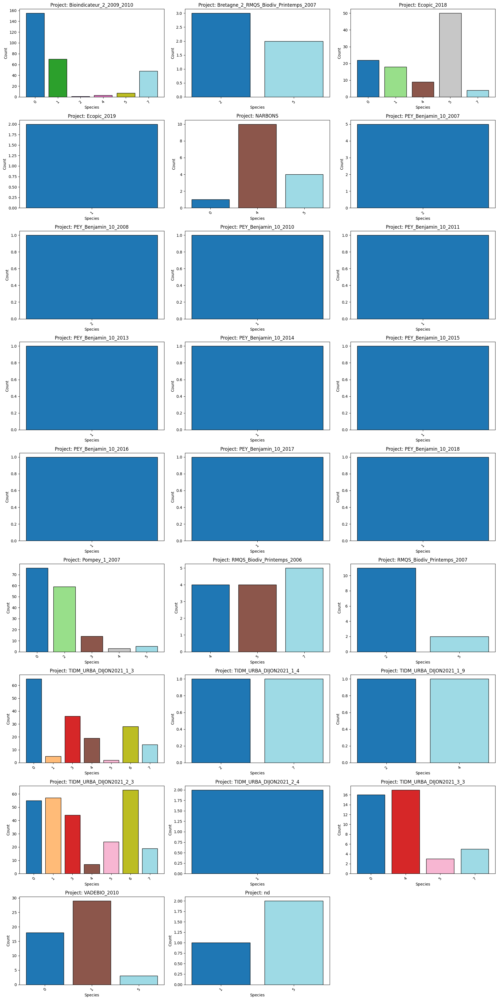

In [80]:
base_dir = '/content/drive/MyDrive/ChallengeIAM2/base_sure_grouped_by_project'
projects = [name for name in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, name))]
projects = sorted(projects)
print("Total Projects:", len(projects))

n_cols = 3
n_rows = math.ceil(len(projects) / n_cols)
fig, axes = plt.subplots(n_rows, n_cols, figsize=(18, n_rows * 4))
axes = axes.flatten()

for i, proj in enumerate(projects):
    proj_dir = os.path.join(base_dir, proj)
    files = [f for f in os.listdir(proj_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]


    species_list = []
    for filename in files:
        parts = filename.split("-")
        if len(parts) < 2:
            continue
        species_token = parts[1]
        species = species_token.split("_")[0]
        species_list.append(species)

    species_counts = Counter(species_list)

    ax = axes[i]
    if not species_counts:
        ax.text(0.5, 0.5, "No data", horizontalalignment='center', verticalalignment='center')
        ax.set_title(f"Project: {proj}")
        ax.axis('off')
        continue

    species_sorted = sorted(species_counts.items(), key=lambda x: x[0])
    species_names = [str(x[0]) for x in species_sorted]
    counts = [x[1] for x in species_sorted]

    cmap = plt.get_cmap("tab20")
    colors = cmap(np.linspace(0, 1, len(species_names)))

    ax.bar(species_names, counts, color=colors, edgecolor='black')
    ax.set_title(f"Project: {proj}")
    ax.set_xlabel("Species")
    ax.set_ylabel("Count")
    ax.tick_params(axis='x', rotation=45)

for j in range(i + 1, len(axes)):
    axes[j].axis('off')

plt.tight_layout()
plt.show()
#Bioindicateur_2_2009_2010

### TSNE with HSVhue-Transformed features

Projects found: ['Pompey_1_2007', 'Bioindicateur_2_2009_2010', 'TIDM_URBA_DIJON2021_2_3', 'Parcelles_Lysime╠ütriques_Sept_2007_2008_3', 'TIDM_URBA_DIJON2021_1_3', 'PEY_Benjamin_10_2007', 'VADEBIO_2010', 'TIDM_URBA_DIJON2021_3_3', 'Ecopic_2018', 'Parcelles_Lysime╠ütriques_Sept_2007_2', 'NARBONS', 'RMQS_Biodiv_Printemps_2007', 'RMQS_Biodiv_Printemps_2006', '_Howe╠ücourt_TQ_09_04_08.Vadebio', 'Parcelles_Lysime╠ütriques_Sept_2007_1', 'PEY_Benjamin_10_2014', 'Bretagne_2_RMQS_Biodiv_Printemps_2007', 'PEY_Benjamin_10_2017', 'PEY_Benjamin_10_2018', 'TIDM_URBA_DIJON2021_1_9', 'TIDM_URBA_DIJON2021_1_4', 'nd', 'PEY_Benjamin_10_2013', 'Celine_Isacs_Litie╠Çre_boite_rouge', 'PEY_Benjamin_10_2008', 'TIDM_URBA_DIJON2021_2_4', 'PEY_Benjamin_10_2010', 'PEY_Benjamin_10_2016', 'PEY_Benjamin_10_2009', 'Ecopic_2019', 'PEY_Benjamin_10_2011', 'PEY_Benjamin_10_2015', 'PEY_Benjamin_10_2012']
Found 1396 images total.
ResNet50 model loaded.
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 807m

/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


t-SNE done.


<ipython-input-57-ba84331b5d46>:100: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap("tab10", len(unique_labels))


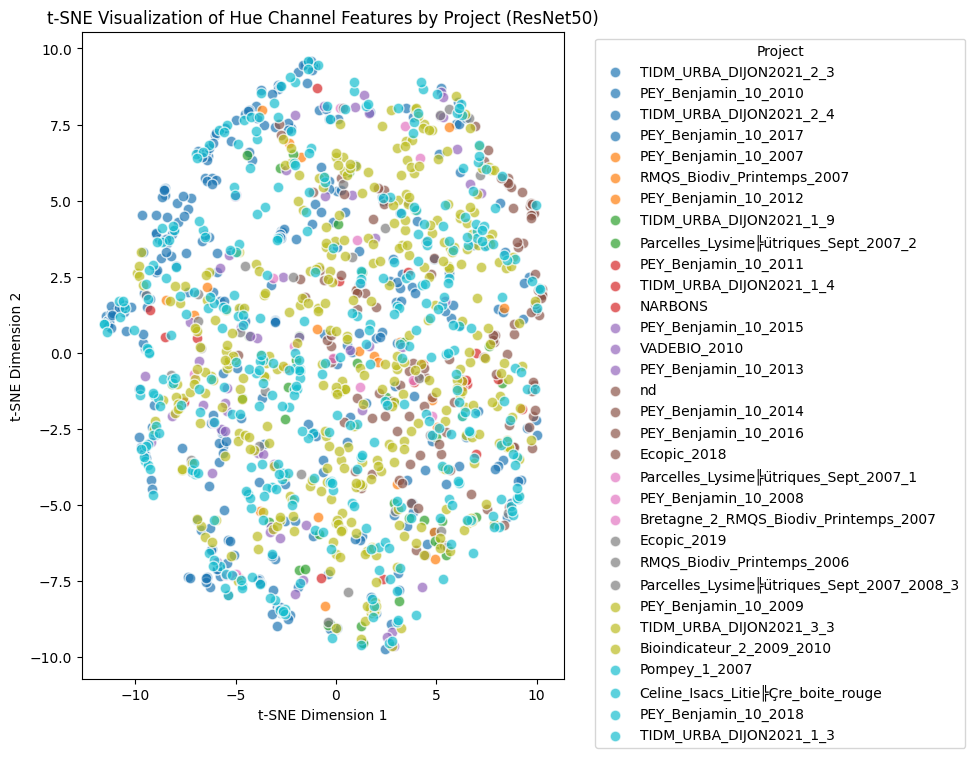

In [ ]:
base_dir = '/content/drive/MyDrive/ChallengeIAM2/imagettes/grouped_by_project'

project_names = [name for name in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, name))]
print("Projects found:", project_names)

image_paths = []
for proj in project_names:
    proj_dir = os.path.join(base_dir, proj)
    files = [f for f in os.listdir(proj_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    for f in files:
        image_paths.append((os.path.join(proj_dir, f), proj))

print(f"Found {len(image_paths)} images total.")

IMG_SIZE = (224, 224)

base_model = ResNet50(weights='imagenet', include_top=False, pooling='avg')
print("ResNet50 model loaded.")

def load_and_preprocess_image_hue(img_path):

    try:
        img = image.load_img(img_path, target_size=IMG_SIZE)
        img_array = image.img_to_array(img)
        img_norm = img_array.astype('float32') / 255.0
        hsv = color.rgb2hsv(img_norm)
        hue = hsv[..., 0]
        hue_3ch = np.stack([hue, hue, hue], axis=-1)
        hue_3ch = (hue_3ch * 255).astype('float32')
        hue_3ch = np.expand_dims(hue_3ch, axis=0)
        hue_3ch = preprocess_input(hue_3ch)
        return hue_3ch
    except Exception as e:
        print(f"Error processing {img_path}: {e}")
        return None

features = []
labels = []
failed = 0
for idx, (img_path, proj) in enumerate(image_paths):
    img_array = load_and_preprocess_image_hue(img_path)
    if img_array is None:
        failed += 1
        continue
    feat = base_model.predict(img_array)
    features.append(feat.flatten())
    labels.append(proj)

print(f"Processed {len(features)} images successfully. Failed: {failed}")
features = np.array(features)

pca = PCA(n_components=50)
features_pca = pca.fit_transform(features)
print("PCA done. Total explained variance:", pca.explained_variance_ratio_.sum())

tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=300)
features_tsne = tsne.fit_transform(features_pca)
print("t-SNE done.")


/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


t-SNE done.


<ipython-input-58-c9c480234905>:9: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap("gist_ncar", 33)


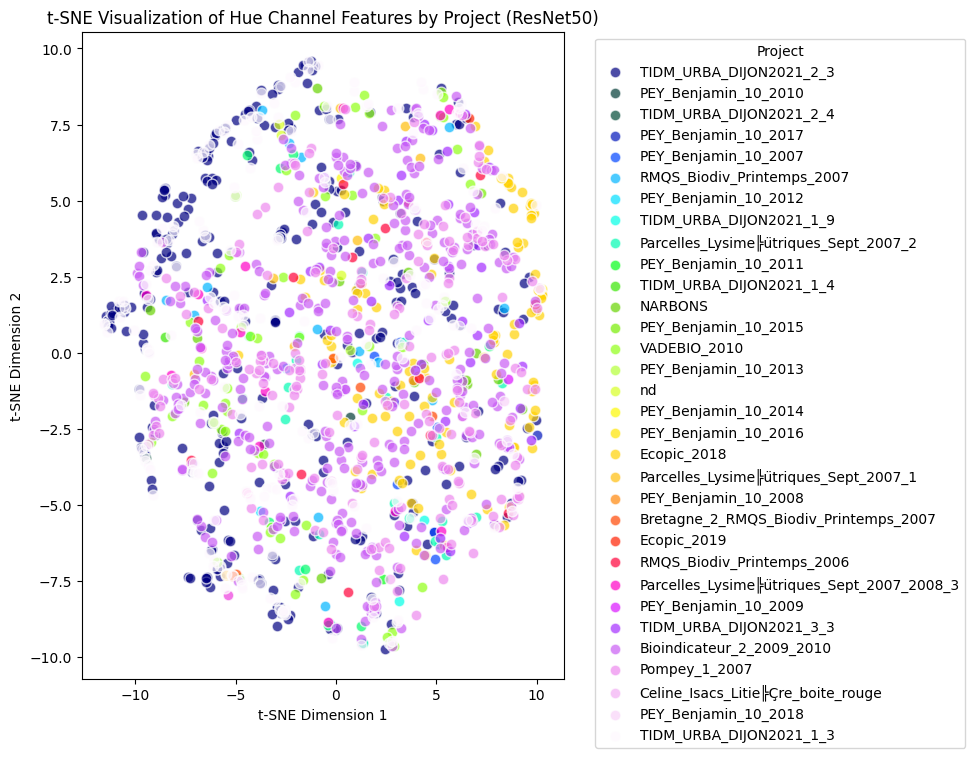

In [ ]:
tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=300)
features_tsne = tsne.fit_transform(features_pca)
print("t-SNE done.")

plt.figure(figsize=(10, 8))
unique_labels = list(set(labels))
colors = plt.cm.get_cmap("gist_ncar", 33)

for i, label in enumerate(unique_labels):
    indices = [j for j, l in enumerate(labels) if l == label]
    plt.scatter(features_tsne[indices, 0], features_tsne[indices, 1],
                label=label, color=colors(i), alpha=0.7, edgecolors='w', s=60)

plt.legend(title="Project", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.title("t-SNE Visualization of Hue Channel Features by Project (ResNet50)")
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.tight_layout()
plt.savefig("/content/tsne_resnet50_transformed_hue.png")
plt.show()


### TSNE with GrayScale-Transformed features

In [64]:
from skimage import color
base_dir = '/content/drive/MyDrive/ChallengeIAM2/imagettes/grouped_by_project'

project_names = [name for name in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, name))]
print("Projects found:", project_names)

image_paths = []
for proj in project_names:
    proj_dir = os.path.join(base_dir, proj)
    files = [f for f in os.listdir(proj_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    for f in files:
        image_paths.append((os.path.join(proj_dir, f), proj))

print(f"Found {len(image_paths)} images total.")

IMG_SIZE = (224, 224)
base_model = ResNet50(weights='imagenet', include_top=False, pooling='avg')
print("ResNet50 model loaded.")

def load_and_preprocess_image_gray(img_path):

    try:
        img = image.load_img(img_path, target_size=IMG_SIZE)
        img_array = image.img_to_array(img)
        img_norm = img_array.astype('float32') / 255.0
        gray = color.rgb2gray(img_norm)
        gray_3ch = np.stack([gray, gray, gray], axis=-1)
        gray_3ch = (gray_3ch * 255).astype('float32')
        gray_3ch = np.expand_dims(gray_3ch, axis=0)
        gray_3ch = preprocess_input(gray_3ch)
        return gray_3ch
    except Exception as e:
        print(f"Error processing {img_path}: {e}")
        return None

features = []
labels = []
failed = 0
for idx, (img_path, proj) in enumerate(image_paths):
    img_array = load_and_preprocess_image_gray(img_path)
    if img_array is None:
        failed += 1
        continue
    feat = base_model.predict(img_array)
    features.append(feat.flatten())
    labels.append(proj)

print(f"Processed {len(features)} images successfully. Failed: {failed}")
features = np.array(features)

pca = PCA(n_components=50)
features_pca = pca.fit_transform(features)
print("PCA done. Total explained variance:", pca.explained_variance_ratio_.sum())

tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=300)
features_tsne = tsne.fit_transform(features_pca)
print("t-SNE done.")


Projects found: ['Pompey_1_2007', 'Bioindicateur_2_2009_2010', 'TIDM_URBA_DIJON2021_2_3', 'Parcelles_Lysime╠ütriques_Sept_2007_2008_3', 'TIDM_URBA_DIJON2021_1_3', 'PEY_Benjamin_10_2007', 'VADEBIO_2010', 'TIDM_URBA_DIJON2021_3_3', 'Ecopic_2018', 'Parcelles_Lysime╠ütriques_Sept_2007_2', 'NARBONS', 'RMQS_Biodiv_Printemps_2007', 'RMQS_Biodiv_Printemps_2006', '_Howe╠ücourt_TQ_09_04_08.Vadebio', 'Parcelles_Lysime╠ütriques_Sept_2007_1', 'PEY_Benjamin_10_2014', 'Bretagne_2_RMQS_Biodiv_Printemps_2007', 'PEY_Benjamin_10_2017', 'PEY_Benjamin_10_2018', 'TIDM_URBA_DIJON2021_1_9', 'TIDM_URBA_DIJON2021_1_4', 'nd', 'PEY_Benjamin_10_2013', 'Celine_Isacs_Litie╠Çre_boite_rouge', 'PEY_Benjamin_10_2008', 'TIDM_URBA_DIJON2021_2_4', 'PEY_Benjamin_10_2010', 'PEY_Benjamin_10_2016', 'PEY_Benjamin_10_2009', 'Ecopic_2019', 'PEY_Benjamin_10_2011', 'PEY_Benjamin_10_2015', 'PEY_Benjamin_10_2012']
Found 1396 images total.
ResNet50 model loaded.
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498m

/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


t-SNE done.


<ipython-input-65-bca2afacbba5>:4: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap("gist_ncar", len(unique_labels))


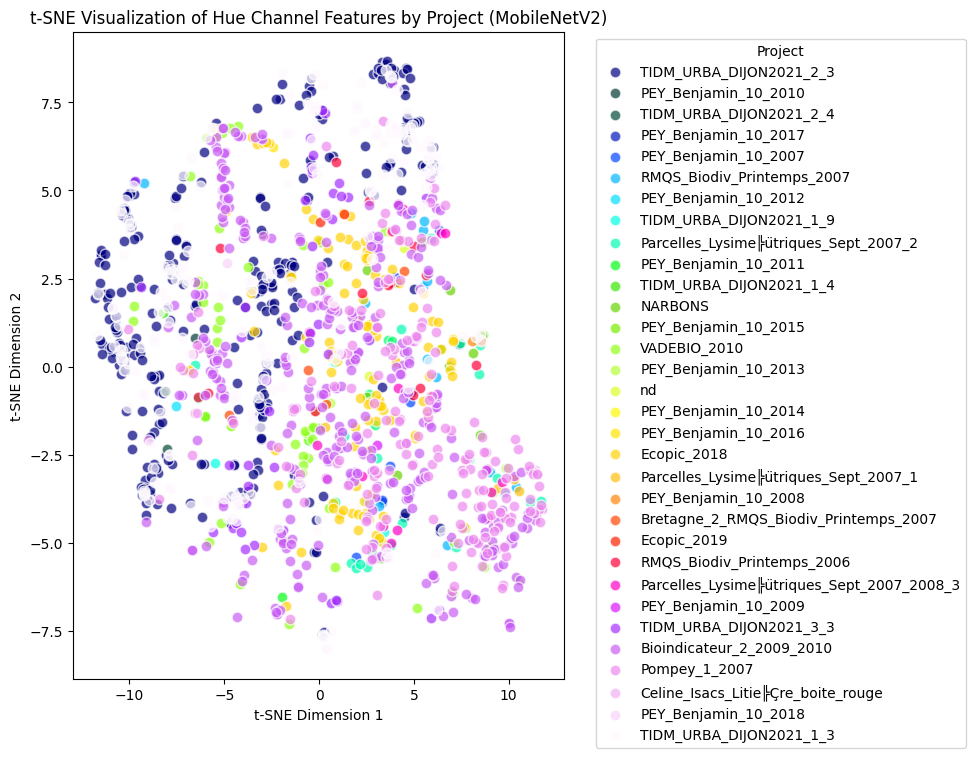

In [65]:
plt.figure(figsize=(10, 8))
unique_labels = list(set(labels))
colors = plt.cm.get_cmap("gist_ncar", len(unique_labels))

for i, label in enumerate(unique_labels):
    indices = [j for j, l in enumerate(labels) if l == label]
    plt.scatter(features_tsne[indices, 0], features_tsne[indices, 1],
                label=label, color=colors(i), alpha=0.7, edgecolors='w', s=60)

plt.legend(title="Project", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.title("t-SNE Visualization of Hue Channel Features by Project (MobileNetV2)")
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.tight_layout()
plt.savefig("/content/tsne_mobilenetv2_transformed_greyscale.png")
plt.show()


### TSNE with L-Lab-Transformed features

Projects found: ['Ecopic_2018', 'TIDM_URBA_DIJON2021_2_3', 'Bioindicateur_2_2009_2010', 'TIDM_URBA_DIJON2021_1_3', 'Pompey_1_2007', 'RMQS_Biodiv_Printemps_2007', 'VADEBIO_2010', 'PEY_Benjamin_10_2010', 'TIDM_URBA_DIJON2021_3_3', 'RMQS_Biodiv_Printemps_2006', 'NARBONS', 'Bretagne_2_RMQS_Biodiv_Printemps_2007', 'TIDM_URBA_DIJON2021_2_4', 'nd', 'PEY_Benjamin_10_2007', 'Ecopic_2019', 'TIDM_URBA_DIJON2021_1_9', 'PEY_Benjamin_10_2008', 'PEY_Benjamin_10_2014', 'TIDM_URBA_DIJON2021_1_4', 'PEY_Benjamin_10_2017', 'PEY_Benjamin_10_2015', 'PEY_Benjamin_10_2018', 'PEY_Benjamin_10_2011', 'PEY_Benjamin_10_2013', 'PEY_Benjamin_10_2016']
Found 1144 images total.
ResNet50 model loaded.
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 265ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 230ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
1/1 ━━━━━━━━━━

/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


t-SNE done.


<ipython-input-82-4e51323f8699>:98: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap("gist_ncar", len(unique_labels))


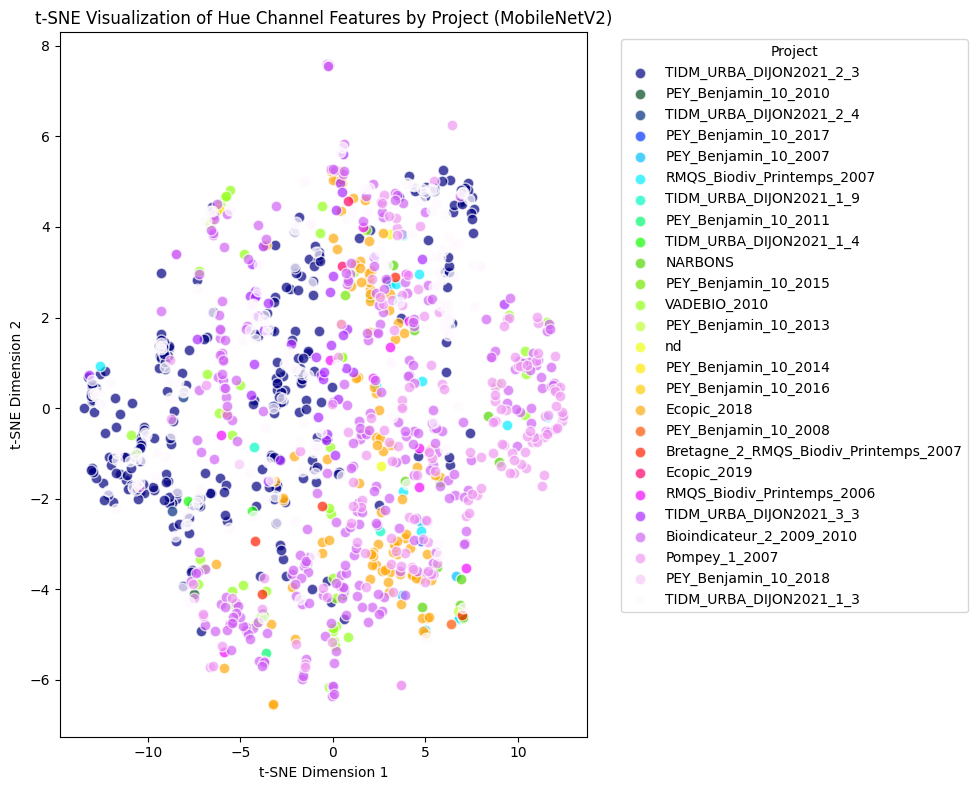

In [82]:
base_dir = '/content/drive/MyDrive/ChallengeIAM2/base_sure_grouped_by_project'

project_names = [name for name in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, name))]
print("Projects found:", project_names)

image_paths = []
for proj in project_names:
    proj_dir = os.path.join(base_dir, proj)
    files = [f for f in os.listdir(proj_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    for f in files:
        image_paths.append((os.path.join(proj_dir, f), proj))

print(f"Found {len(image_paths)} images total.")
IMG_SIZE = (224, 224)

base_model = ResNet50(weights='imagenet', include_top=False, pooling='avg')
print("ResNet50 model loaded.")

def load_and_preprocess_image_lab(img_path):

    try:
        img = image.load_img(img_path, target_size=IMG_SIZE)
        img_array = image.img_to_array(img)
        img_norm = img_array.astype('float32') / 255.0
        lab = color.rgb2lab(img_norm)
        L_channel = lab[..., 0]
        L_scaled = (L_channel / 100.0) * 255.0
        L_3ch = np.stack([L_scaled, L_scaled, L_scaled], axis=-1)
        L_3ch = L_3ch.astype('float32')
        L_3ch = np.expand_dims(L_3ch, axis=0)
        L_3ch = preprocess_input(L_3ch)
        return L_3ch
    except Exception as e:
        print(f"Error processing {img_path}: {e}")
        return None

features = []
labels = []
failed = 0
for idx, (img_path, proj) in enumerate(image_paths):
    img_array = load_and_preprocess_image_lab(img_path)
    if img_array is None:
        failed += 1
        continue
    feat = base_model.predict(img_array)
    features.append(feat.flatten())
    labels.append(proj)

print(f"Processed {len(features)} images successfully. Failed: {failed}")
features = np.array(features)

pca = PCA(n_components=50)
features_pca = pca.fit_transform(features)
print("PCA done. Total explained variance:", pca.explained_variance_ratio_.sum())

tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=300)
features_tsne = tsne.fit_transform(features_pca)
print("t-SNE done.")
plt.figure(figsize=(10, 8))
unique_labels = list(set(labels))
colors = plt.cm.get_cmap("gist_ncar", len(unique_labels))

for i, label in enumerate(unique_labels):
    indices = [j for j, l in enumerate(labels) if l == label]
    plt.scatter(features_tsne[indices, 0], features_tsne[indices, 1],
                label=label, color=colors(i), alpha=0.7, edgecolors='w', s=60)

plt.legend(title="Project", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.title("t-SNE Visualization of Hue Channel Features by Project (MobileNetV2)")
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.tight_layout()
plt.savefig("/content/tsne_mobilenetv2_transformed_LABLe.png")
plt.show()


### TSNE with Gabor-Transformed features

Projects found: ['Pompey_1_2007', 'Bioindicateur_2_2009_2010', 'TIDM_URBA_DIJON2021_2_3', 'Parcelles_Lysime╠ütriques_Sept_2007_2008_3', 'TIDM_URBA_DIJON2021_1_3', 'PEY_Benjamin_10_2007', 'VADEBIO_2010', 'TIDM_URBA_DIJON2021_3_3', 'Ecopic_2018', 'Parcelles_Lysime╠ütriques_Sept_2007_2', 'NARBONS', 'RMQS_Biodiv_Printemps_2007', 'RMQS_Biodiv_Printemps_2006', '_Howe╠ücourt_TQ_09_04_08.Vadebio', 'Parcelles_Lysime╠ütriques_Sept_2007_1', 'PEY_Benjamin_10_2014', 'Bretagne_2_RMQS_Biodiv_Printemps_2007', 'PEY_Benjamin_10_2017', 'PEY_Benjamin_10_2018', 'TIDM_URBA_DIJON2021_1_9', 'TIDM_URBA_DIJON2021_1_4', 'nd', 'PEY_Benjamin_10_2013', 'Celine_Isacs_Litie╠Çre_boite_rouge', 'PEY_Benjamin_10_2008', 'TIDM_URBA_DIJON2021_2_4', 'PEY_Benjamin_10_2010', 'PEY_Benjamin_10_2016', 'PEY_Benjamin_10_2009', 'Ecopic_2019', 'PEY_Benjamin_10_2011', 'PEY_Benjamin_10_2015', 'PEY_Benjamin_10_2012']
Found 1396 images total.
ResNet50 model loaded.
1/1 ━━━━━━━━━━━━━━━━━━━━ 5s 5s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 406m

/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


t-SNE done.


<ipython-input-83-787a40b2c2da>:121: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap("gist_ncar", 33)


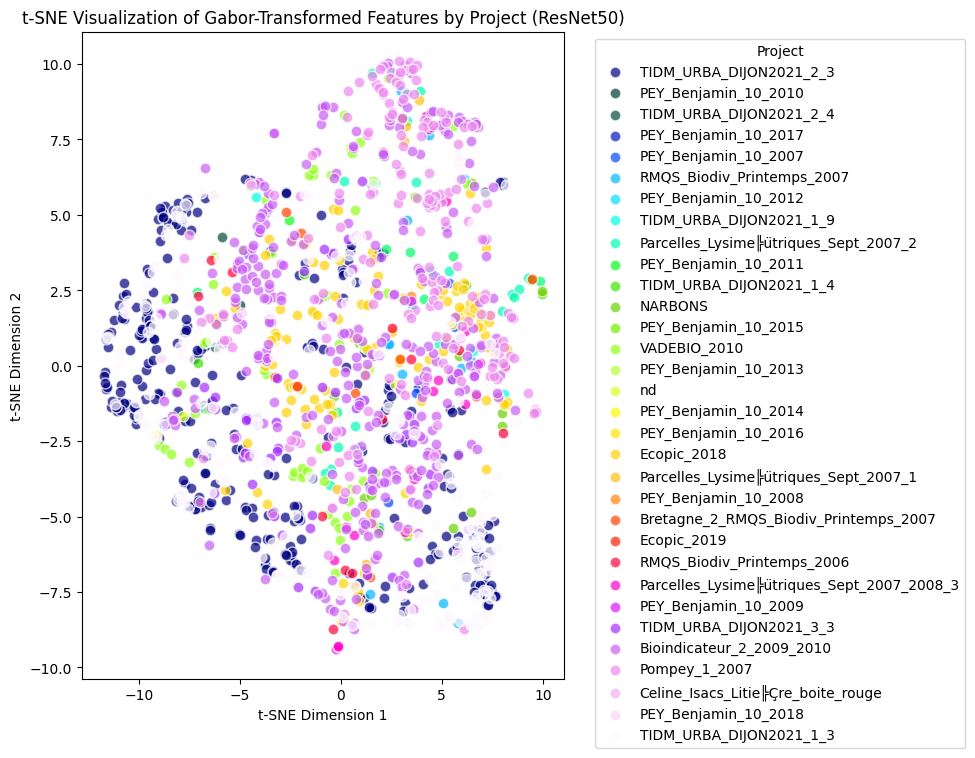

In [83]:
base_dir = '/content/drive/MyDrive/ChallengeIAM2/imagettes/grouped_by_project'

project_names = [name for name in os.listdir(base_dir) if os.path.isdir(os.path.join(base_dir, name))]
print("Projects found:", project_names)

image_paths = []
for proj in project_names:
    proj_dir = os.path.join(base_dir, proj)
    files = [f for f in os.listdir(proj_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]
    for f in files:
        image_paths.append((os.path.join(proj_dir, f), proj))

print(f"Found {len(image_paths)} images total.")

IMG_SIZE = (224, 224)

base_model = ResNet50(weights='imagenet', include_top=False, pooling='avg')
print("ResNet50 model loaded.")

def load_and_preprocess_image_gabor(img_path, frequency=0.6):

    try:
        img = image.load_img(img_path, target_size=IMG_SIZE)
        img_array = image.img_to_array(img)

        img_norm = img_array.astype('float32') / 255.0

        gray = color.rgb2gray(img_norm)

        real_response, _ = gabor(gray, frequency=frequency)

        real_min, real_max = real_response.min(), real_response.max()
        if real_max - real_min > 0:
            real_norm = (real_response - real_min) / (real_max - real_min)
        else:
            real_norm = real_response
        real_scaled = real_norm * 255.0

        gabor_3ch = np.stack([real_scaled, real_scaled, real_scaled], axis=-1)
        gabor_3ch = gabor_3ch.astype('float32')
        gabor_3ch = np.expand_dims(gabor_3ch, axis=0)
        gabor_3ch = preprocess_input(gabor_3ch)

        return gabor_3ch
    except Exception as e:
        print(f"Error processing {img_path}: {e}")
        return None

features = []
labels = []
failed = 0
for idx, (img_path, proj) in enumerate(image_paths):
    img_array = load_and_preprocess_image_gabor(img_path)
    if img_array is None:
        failed += 1
        continue
    feat = base_model.predict(img_array)
    features.append(feat.flatten())
    labels.append(proj)

print(f"Processed {len(features)} images successfully. Failed: {failed}")
features = np.array(features)

pca = PCA(n_components=50)
features_pca = pca.fit_transform(features)
print("PCA done. Total explained variance:", pca.explained_variance_ratio_.sum())

tsne = TSNE(n_components=2, random_state=42, perplexity=30, n_iter=300)
features_tsne = tsne.fit_transform(features_pca)
print("t-SNE done.")

plt.figure(figsize=(10, 8))
unique_labels = list(set(labels))
colors = plt.cm.get_cmap("gist_ncar", 33)

for i, label in enumerate(unique_labels):
    indices = [j for j, l in enumerate(labels) if l == label]
    plt.scatter(features_tsne[indices, 0], features_tsne[indices, 1],
                label=label, color=colors(i), alpha=0.7, edgecolors='w', s=60)

plt.legend(title="Project", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.title("t-SNE Visualization of Gabor-Transformed Features by Project (ResNet50)")
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.tight_layout()
plt.show()


<ipython-input-84-dc7f465162e1>:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  colors = plt.cm.get_cmap("gist_ncar", 33)


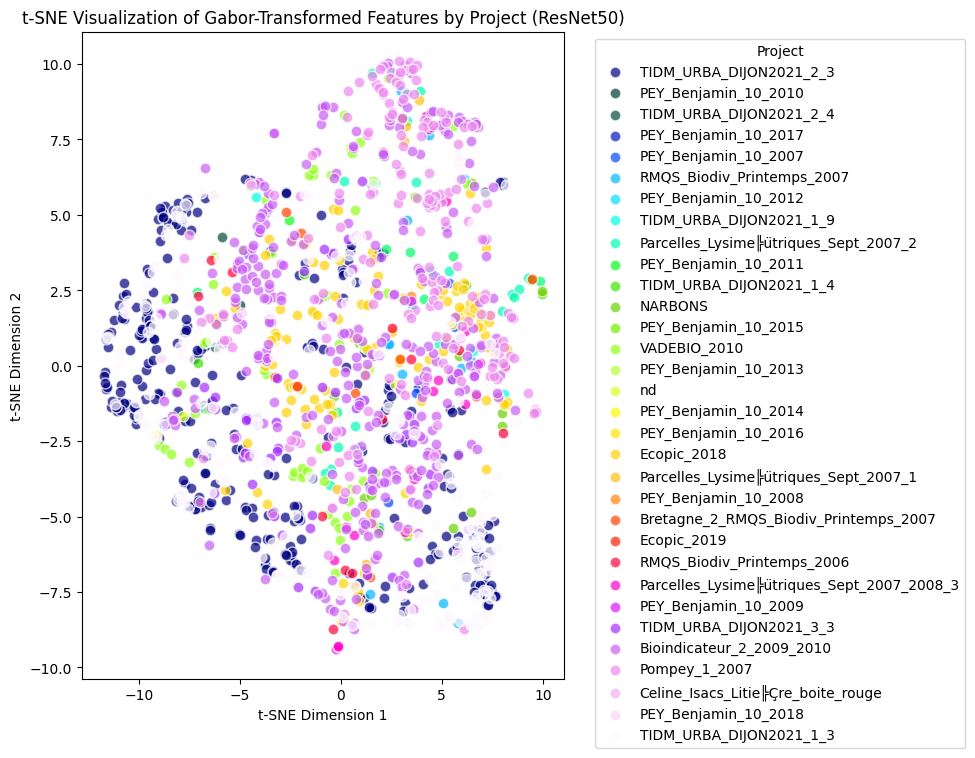

In [84]:
plt.figure(figsize=(10, 8))
unique_labels = list(set(labels))
colors = plt.cm.get_cmap("gist_ncar", 33)

for i, label in enumerate(unique_labels):
    indices = [j for j, l in enumerate(labels) if l == label]
    plt.scatter(features_tsne[indices, 0], features_tsne[indices, 1],
                label=label, color=colors(i), alpha=0.7, edgecolors='w', s=60)

plt.legend(title="Project", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.title("t-SNE Visualization of Gabor-Transformed Features by Project (ResNet50)")
plt.xlabel("t-SNE Dimension 1")
plt.ylabel("t-SNE Dimension 2")
plt.tight_layout()
plt.savefig("/content/tsne_resnet50_transformed_gabor.png")
plt.show()
